<center> <span style="font-family:newtimeroman"> <span style="padding:300px;display:fill;border-radius:250px 250px;background-color:#D72A2B;font-size:180%;font-weight: 600;color:#F2ECC6;overflow:hidden;"> 5.4. Gaussian Mixture Clusteringㅤ</span>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">
    
### ✍️Gaussian Mixture Clustering

**Gaussian Mixture Clustering** is a popular machine-learning algorithm used for unsupervised learning tasks, such as clustering and density estimation. It is based on the assumption that the data points are generated from a mixture of Gaussian distributions. In other words, each cluster is assumed to follow a Gaussian distribution, and the entire dataset is a mixture of these Gaussian distributions. The algorithm uses the Expectation-Maximization (EM) algorithm to estimate the parameters of the Gaussian distributions, which represent the mean and covariance of each cluster. The Gaussian Mixture Clustering algorithm then assigns each data point to a cluster based on the probability of belonging to that cluster. Gaussian Mixture Clustering has several advantages, such as being able to handle non-linearly separable data, dealing with missing or incomplete data, and being able to estimate the number of clusters automatically.
    
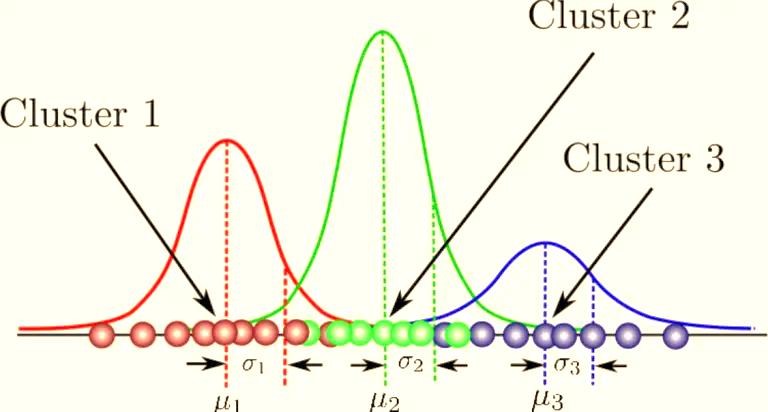

In [99]:
# Calculate silhouette coefficient and calinski harabasz coefficient
silhouette_coef = []
for n_components in range(2,11):
    gmm = GaussianMixture(n_components=n_components, random_state=0)
    labels = gmm.fit_predict(scaled_col)
    score = silhouette_score(scaled_col, labels)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for n_components in range(2,11):
    gmm = GaussianMixture(n_components=n_components, random_state=0)
    gmm.fit(scaled_col)
    score = metrics.calinski_harabasz_score(scaled_col, gmm.predict(scaled_col))
    calinski_harabasz_coef.append(score)

In [100]:
# Create a dataframe to store the scores
scores_GaussianMixture = pd.DataFrame({'n_components': range(2,11),
'Silhouette Score': silhouette_coef,
'Calinski-Harabasz Score': calinski_harabasz_coef})

# Find the best k for each score
best_k_silhouette = scores_GaussianMixture.loc[scores_GaussianMixture['Silhouette Score'].idxmax(), 'n_components']
best_k_calinski_harabaz = scores_GaussianMixture.loc[scores_GaussianMixture['Calinski-Harabasz Score'].idxmax(), 'n_components']

In [101]:
print("\nScores for Different Numbers of Clusters:")
scores_GaussianMixture.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()


Scores for Different Numbers of Clusters:


n_components,Silhouette Score,Calinski-Harabasz Score
2,0.184996,1236.775204
3,0.097791,815.627769
4,0.097438,806.570861
5,0.071824,677.942924
6,0.050039,552.126282
7,0.038547,489.013299
8,0.051703,481.648020
9,0.037216,463.294275
10,0.017723,430.394277


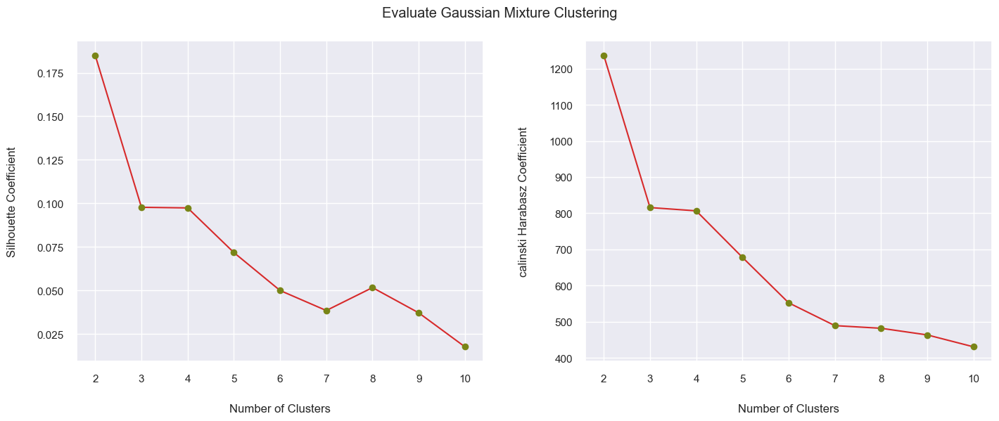

In [102]:
# Visualize plots of silhouette and calinski harabasz scores for Gaussian Mixture models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Gaussian Mixture')

#### 🌴Find the best 'k' for Silhouette and Calinski-Harabasz

In [103]:
# Best k for each coef
print(f"\n▪️Best k for Silhouette Coefficient: {best_k_silhouette}")
print(f"▪️Best k for Calinski-Harabasz Coefficient: {best_k_calinski_harabaz}")


▪️Best k for Silhouette Coefficient: 2
▪️Best k for Calinski-Harabasz Coefficient: 2


#### 🌴Implement Gaussian Mixture with the Best Number of Components

In [104]:
# Run GMM with n_components=2
gmm = GaussianMixture(n_components=2, random_state=0).fit(scaled_col)

# Get the cluster labels assigned to each data point by GMM
cluster_labels = gmm.predict(scaled_col)

# Get the coordinates of the centroids of the two clusters
centroids = np.zeros((2, scaled_col.shape[1]))
for i in range(2):
    cluster_i = scaled_col[cluster_labels == i]
    centroids[i,:] = cluster_i.mean(axis=0)

# Convert the centroids array to a DataFrame and assign column names
centroids = pd.DataFrame(centroids, columns=scaled_col.columns)
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.240630,0.338566,0.634264,0.514324,0.555112,-0.018870,0.756992,0.808050,0.540080,-0.156709,-0.088871,0.731217,0.391397,0.442075,0.288322,0.187847,0.209596
1,-0.132705,-0.186716,-0.349791,-0.283645,-0.306139,0.010407,-0.417474,-0.445632,-0.297849,0.086424,0.049012,-0.403260,-0.215852,-0.243800,-0.159007,-0.103596,-0.115590


In [105]:
# Get the cluster labels assigned to each data point by GMM
pred = gmm.predict(scaled_col)

# Convert the centroids from scaled values to the original scale
real_centroids = scaler.inverse_transform(centroids)

# Convert the centroids array to a DataFrame and assign column names
real_centroids = pd.DataFrame(real_centroids, columns=df.columns)
real_centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,2065.510706,0.957518,2358.490148,1446.218082,913.116652,939.386037,0.794214,0.443545,0.579122,0.103780,2.642565,32.887457,5918.59313,3013.146871,1517.593998,0.208676,11.798177
1,1288.426101,0.833139,255.951127,121.687717,134.263410,1000.784088,0.322857,0.069536,0.246104,0.152436,3.583564,4.687587,3709.04705,1027.532635,474.075684,0.123431,11.363384


#### 🌴Evaluation of the performance of the Gaussian Mixture model

In [106]:
# Calculate scores
silhouette = silhouette_score(scaled_col, pred)
calinski = calinski_harabasz_score(scaled_col, pred)

# Create a DataFrame with the scores
GaussianMixture_scores = pd.DataFrame({'Silhouette Score': [silhouette], 'Calinski-Harabasz Score': [calinski]}, index=['GaussianMixture'])
GaussianMixture_scores

,Silhouette Score,Calinski-Harabasz Score
GaussianMixture,0.184996,1236.775204


#### 🌴Addition of Cluster Column to the Data frame

In [107]:
gmm_clustered_df = pd.concat([df, pd.DataFrame(pred, columns=['GMM Cluster'])], axis = 1)
gmm_clustered_df.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['GMM Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,GMM Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.000000,0.000000,0.000000,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.000000,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.170000,773.170000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.000000,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.000000,1499.000000,0.000000,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.000000,0.000000,312.452292,0.000000,12,0
4,817.714335,1.000000,16.000000,16.000000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.000000,678.334763,244.791237,0.000000,12,1
5,1809.828751,1.000000,1333.280000,0.000000,1333.280000,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.000000,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.010000,6402.630000,688.380000,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.000000,6354.314328,198.065894,1.000000,12,0
7,1823.652743,1.000000,436.200000,0.000000,436.200000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.000000,679.065082,532.033990,0.000000,12,1
8,1014.926473,1.000000,861.490000,661.490000,200.000000,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.000000,688.278568,311.963409,0.000000,12,1
9,152.225975,0.545455,1281.600000,1281.600000,0.000000,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.000000,1164.770591,100.302262,0.000000,12,1


In [108]:
gmm_clustered_df.shape

(8949, 18)

#### 🌴Size of the Clusters

In [109]:
GMM_clust_sizes = gmm_clustered_df.groupby('GMM Cluster').size().to_frame()
GMM_clust_sizes.columns = ["Gaussian Mixture Size"]
GMM_clust_sizes

,Gaussian Mixture Size
GMM Cluster,
0,3181
1,5768


#### 🌴Distribution of Data Points by Cluster

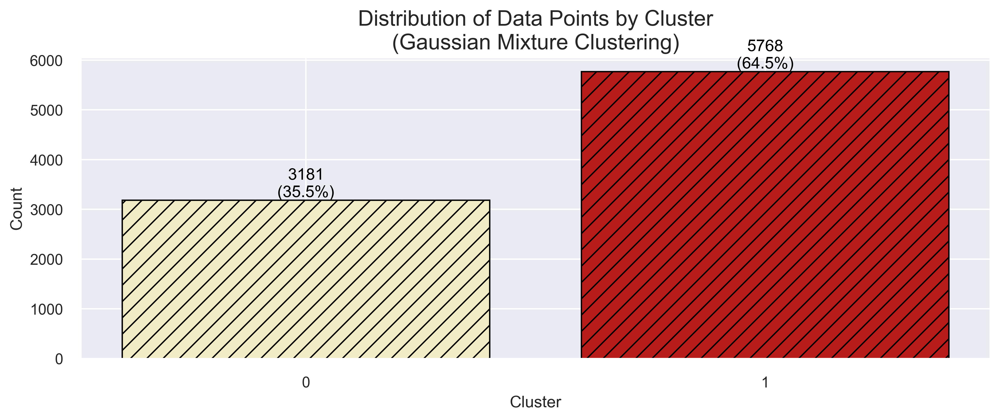

In [110]:
# Distribution of Data Points by Cluster
counts = gmm_clustered_df['GMM Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6"]
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(Gaussian Mixture Clustering)', fontsize= 16)
plt.show()

#### 🌴Distribution of data in different clusters

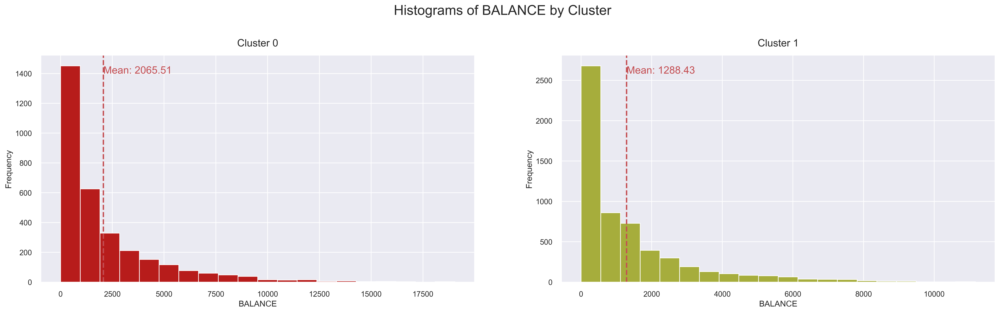

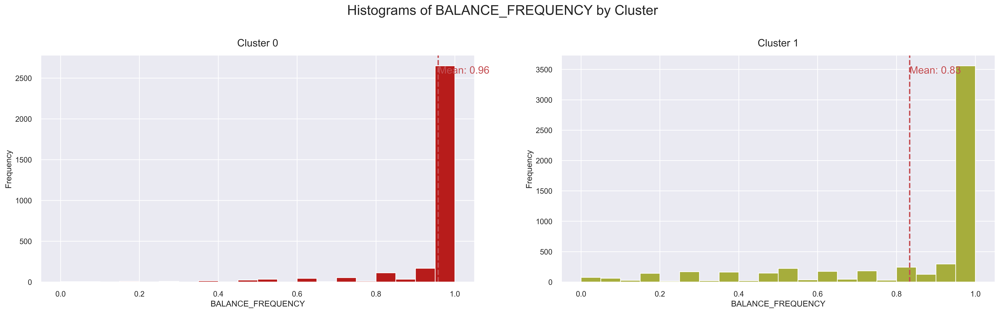

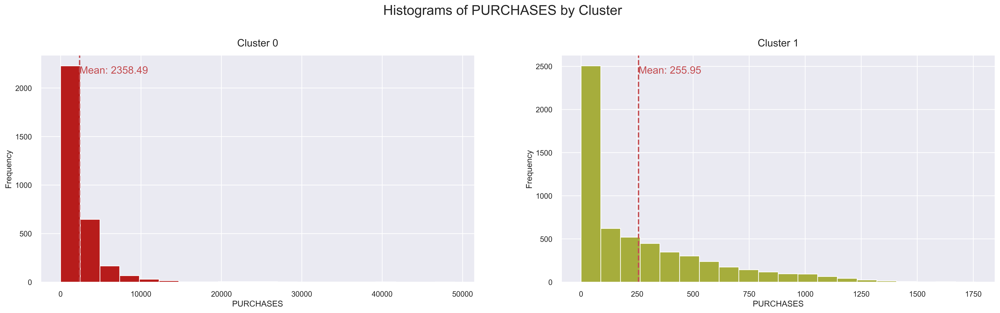

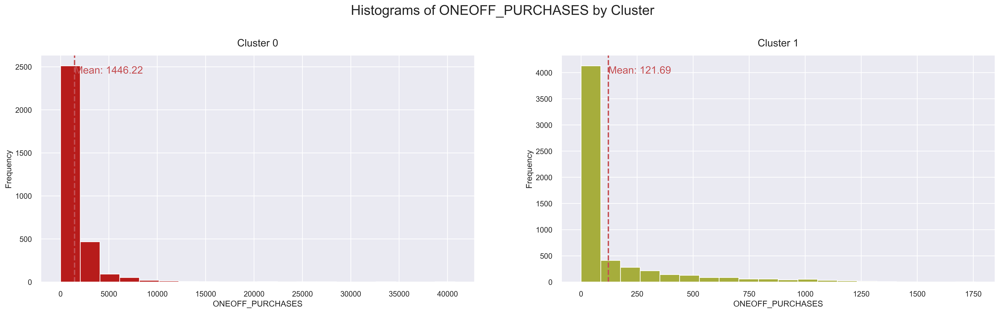

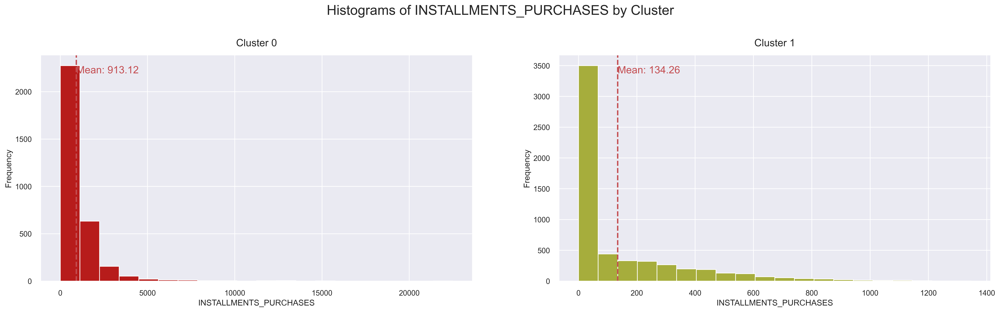

...

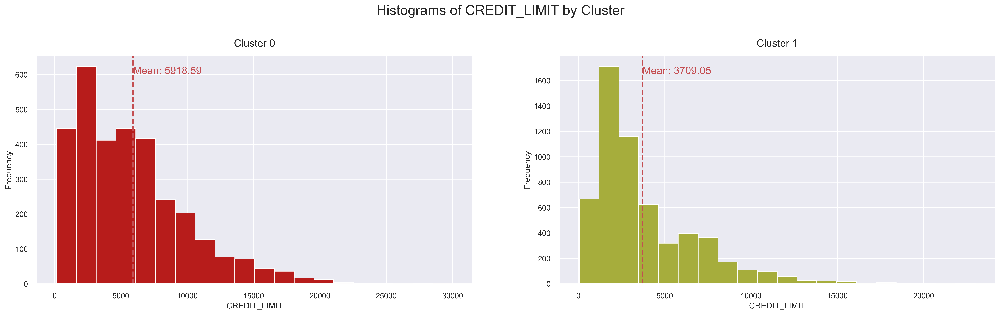

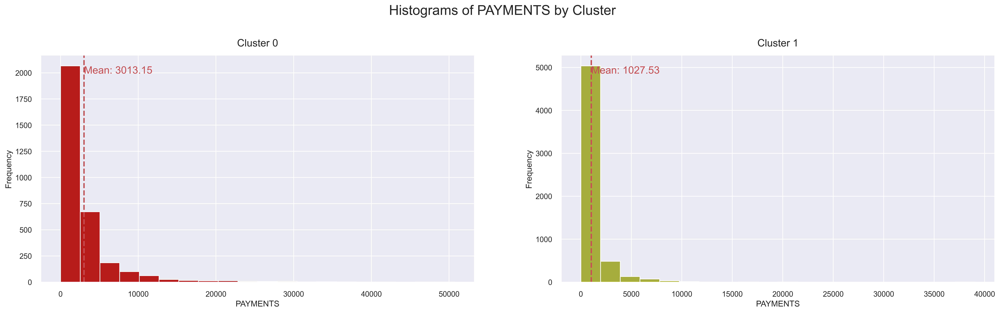

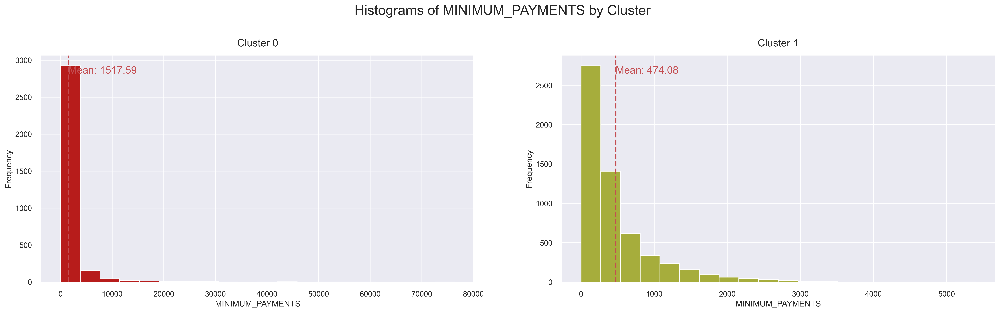

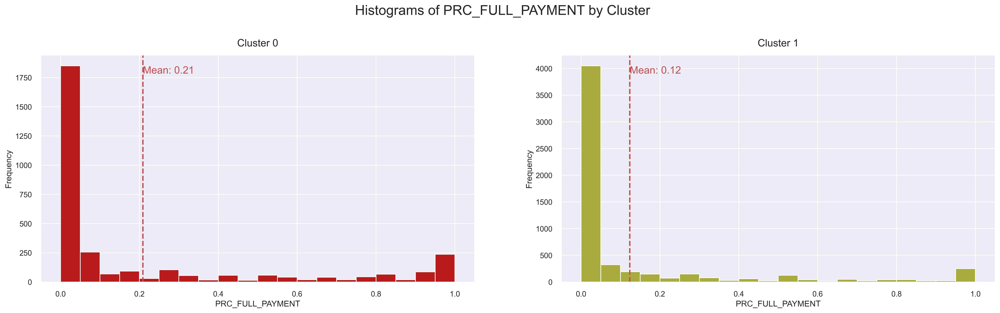

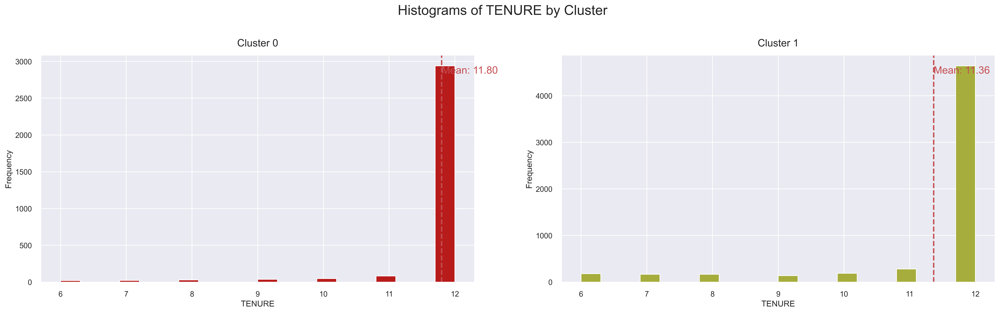

In [111]:
# Define custom color palette
colors = ["#B71C1B", "#A6AD3C"]

# Plot the histogram of various clusters
for col in df.columns:
    # Create a figure with subplots for each cluster
    fig, axes = plt.subplots(1, 2, figsize=(25,6))
    # Set the figure title
    fig.suptitle(f'Histograms of {col} by Cluster', fontsize=20, y=1.05)
    for j in range(2):
        # Select data for the current cluster and column
        cluster = gmm_clustered_df[gmm_clustered_df['GMM Cluster'] == j][col]
        # Plot the histogram for the current cluster and column
        counts, bins, patches = axes[j].hist(cluster, bins=20, color=colors[j])
        # Calculate and add the mean line to the histogram
        mean = cluster.mean()
        axes[j].axvline(mean, color='r', linestyle='dashed', linewidth=2)
        ymin, ymax = axes[j].get_ylim()
        axes[j].text(mean, ymax*0.95, f"Mean: {mean:.2f}", ha='left', va='top', color='r', fontsize=15)
        # Set the subplot title and axis labels
        axes[j].set_title(f'Cluster {j}', fontsize=15, y=1.02)
        axes[j].set_xlabel(col, fontsize=12)
        axes[j].set_ylabel('Frequency', fontsize=12)
    # Adjust the spacing between subplots and display the plot
    plt.subplots_adjust(wspace=0.2)
    plt.show()

#### 🌴Cluster Analysis and customers segmentation (Scaled data)

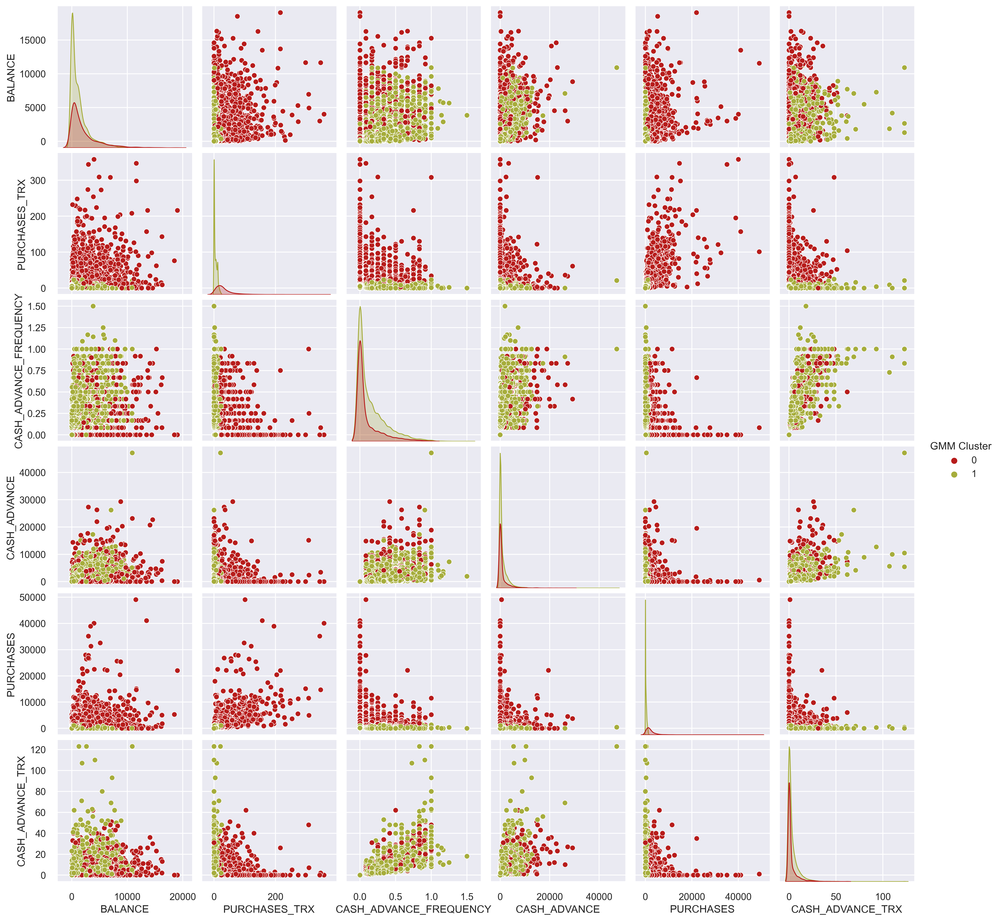

In [112]:
# Pairplot (Scaled data)
colors = ["#B71C1B","#A6AD3C"]

important_variables = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX', 'GMM Cluster']

sns.set_style('darkgrid')
sns.pairplot(gmm_clustered_df[important_variables], hue='GMM Cluster', palette=colors)
plt.show()

In [113]:
# Summarizing the average values of each feature within each cluster
avg_df = gmm_clustered_df.groupby(['GMM Cluster'], as_index=False).mean()
avg_df.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()

GMM Cluster,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,2065.510706,0.957518,2358.490148,1446.218082,913.116652,939.386037,0.794214,0.443545,0.579122,0.103780,2.642565,32.887457,5918.593130,3013.146871,1517.593998,0.208676,11.798177
1,1288.426101,0.833139,255.951127,121.687717,134.263410,1000.784088,0.322857,0.069536,0.246104,0.152436,3.583564,4.687587,3709.047050,1027.532635,474.075684,0.123431,11.363384


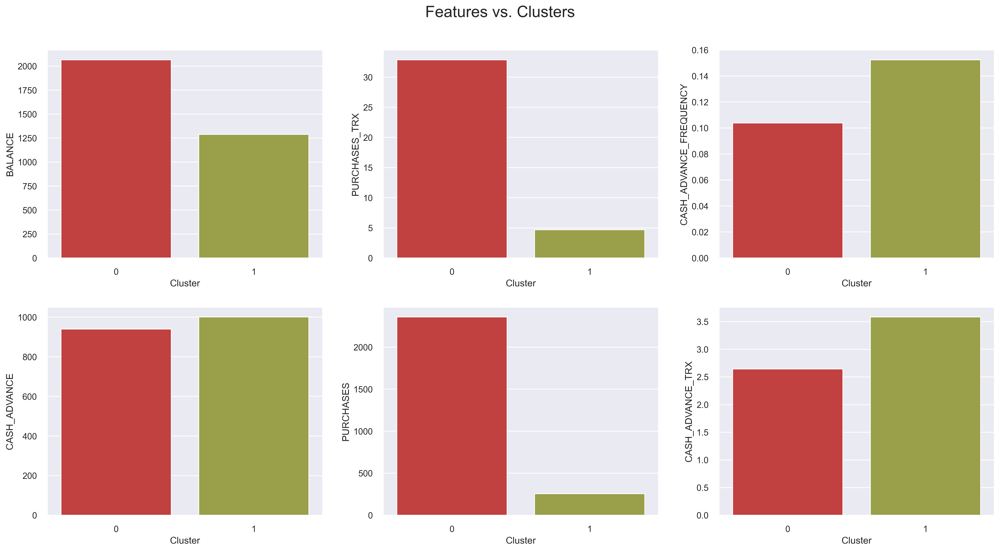

In [114]:
custom_colors = ["#D72A2B", "#A6AD3C"]

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
for i, col in enumerate(['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']):
    sns.barplot(x='GMM Cluster', y=col, data=avg_df, ax=axes[i//3][i%3], palette=custom_colors)
    axes[i//3][i%3].set_xlabel('Cluster')
    axes[i//3][i%3].set_ylabel(col)
plt.suptitle('Features vs. Clusters', fontsize=20)
fig.tight_layout(pad=2.0)
plt.show()

In [115]:
db_g = pd.DataFrame(gmm_clustered_df.groupby(['GMM Cluster','TENURE'])['TENURE'].count())
db_g.T.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'})

#### 🌴Distribution of the most important features after Clustering

In [116]:
features = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']

for feature in features:
    fig = px.histogram(gmm_clustered_df, x=feature, color='GMM Cluster', template=temp,
                       marginal='box', opacity=0.7, nbins=50, color_discrete_sequence=[colors_mix[2],colors_mix[7]],
                       barmode='group', histfunc='count')
    
    fig.update_layout(
        font_family='monospace',
        title=dict(text=f'Distribution of {feature} After Clustering', x=0.5, y=0.95,
                   font=dict(color=colors_dark[2], size=20)),
        xaxis_title_text=feature,
        yaxis_title_text='Count',
        legend=dict(x=1, y=0.96, bordercolor=colors_dark[4], borderwidth=0, tracegroupgap=5),
        bargap=0.3,
    )
    fig.show()

#### 🌴Cluster Analysis and customers segmentation (Orginal data)

In [117]:
# Create an instance of the GaussianMixture Clustering class with the specified parameters
gmm = GaussianMixture(n_components=2, random_state=0)

# Fit the clustering model to the data and predict the cluster labels for each observation
pred = gmm.fit_predict(df)

# Create a copy of the original DataFrame to avoid modifying it directly
df_gmm = df.copy()

# Add a new column to the DataFrame with the predicted cluster labels
df_gmm["GMM Cluster"] = pred

# Sort the DataFrame by the cluster labels to group similar observations together
df_gmm = df_gmm.sort_values(by='GMM Cluster')

# Convert the cluster labels to categorical variables for easier analysis
df_gmm['GMM Cluster'] = df_gmm['GMM Cluster'].astype('category')

In [118]:
df_gmm.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['GMM Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,GMM Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
5848,89.165814,0.833333,724.000000,0.000000,724.000000,0.000000,0.833333,0.000000,0.833333,0.000000,0,6,1000.000000,521.867766,88.700517,0.000000,6,0
5847,1196.183155,0.909091,166.800000,166.800000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,7000.000000,1910.836556,359.989055,0.000000,12,0
5846,399.988157,1.000000,5277.770000,4004.960000,1272.810000,0.000000,1.000000,1.000000,0.916667,0.000000,0,57,6000.000000,4353.346961,194.598709,1.000000,12,0
5843,1150.307564,1.000000,1189.040000,0.000000,1189.040000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,15000.000000,3016.935137,332.492063,0.000000,12,0
5842,350.306089,0.333333,0.000000,0.000000,0.000000,1438.822819,0.000000,0.000000,0.000000,0.333333,7,0,1500.000000,57.290411,188.739997,0.000000,6,0
5841,7969.504857,1.000000,0.000000,0.000000,0.000000,4714.040663,0.000000,0.000000,0.000000,0.500000,16,0,11500.000000,2184.446847,2086.545633,0.000000,12,0
5837,2886.330537,1.000000,0.000000,0.000000,0.000000,275.617952,0.000000,0.000000,0.000000,0.416667,6,0,3000.000000,3628.742239,1039.604463,0.083333,12,0
5836,1541.047251,1.000000,100.000000,0.000000,100.000000,0.000000,0.166667,0.000000,0.166667,0.000000,0,2,7000.000000,325.179537,329.548006,0.000000,12,0
5835,338.310239,1.000000,2855.040000,2488.950000,366.090000,0.000000,0.750000,0.250000,0.583333,0.000000,0,15,6000.000000,2801.205072,125.713305,0.375000,12,0


In [119]:
df_gmm.shape

(8949, 18)

#### 🌴Distribution of Data Points by Cluster

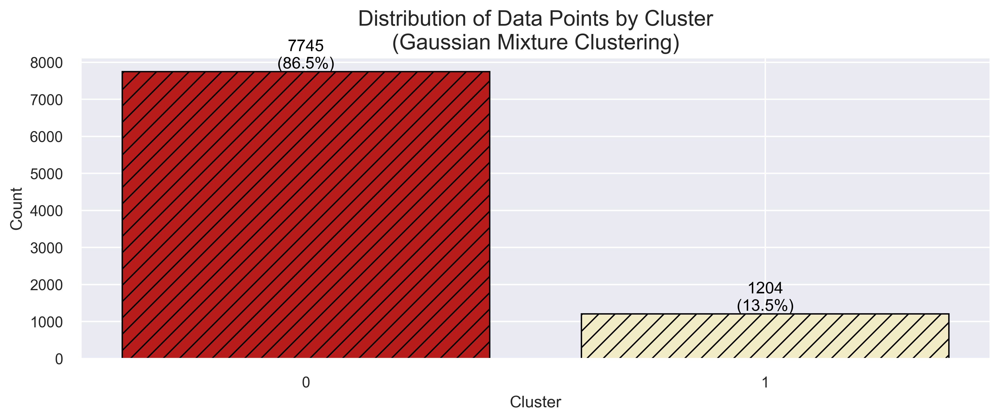

In [120]:
# Distribution of Data Points by Cluster
counts = df_gmm['GMM Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6"]
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(Gaussian Mixture Clustering)', fontsize= 16)
plt.show()

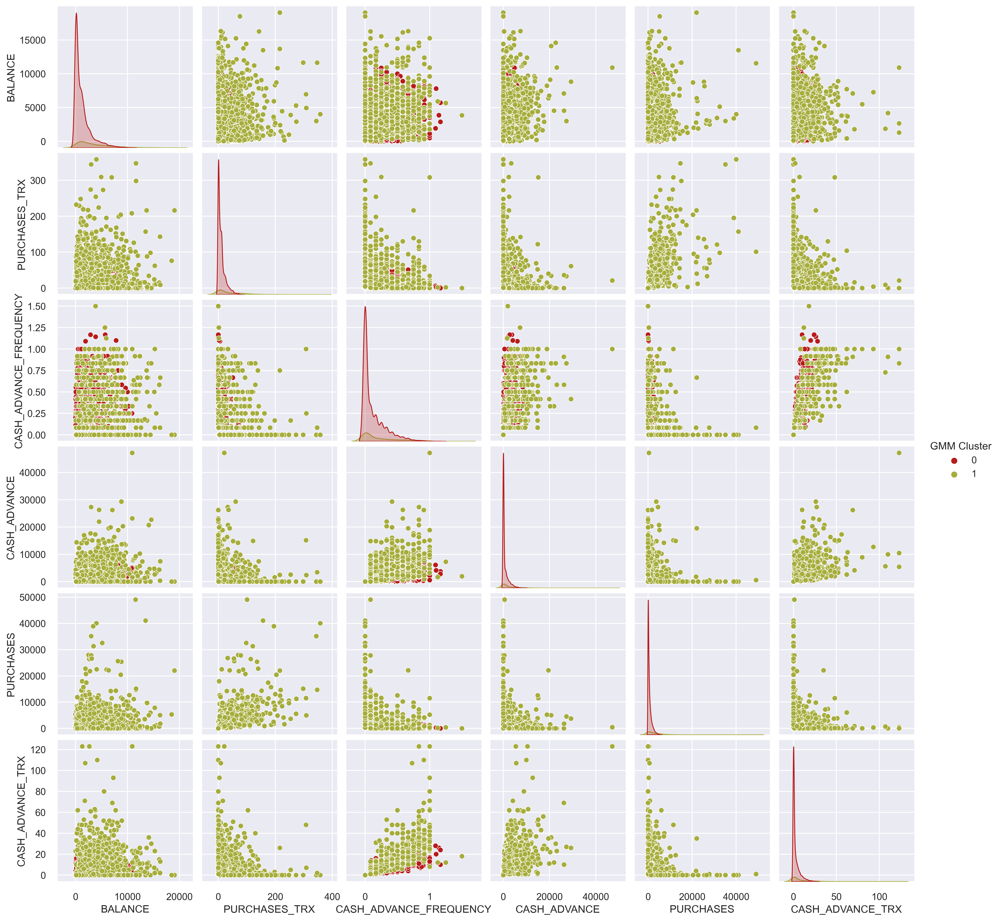

In [121]:
# Pairplot (Original data)
colors = ["#B71C1B","#A6AD3C"]

sns.set_style('darkgrid')
sns.pairplot(df_gmm[important_variables], hue='GMM Cluster', palette=colors)
plt.show()

In [122]:
# Plot of clusters
fig = px.scatter(df_gmm, x="PURCHASES", y="CASH_ADVANCE_TRX", color="GMM Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="Gaussian Mixture Cluster Profiles,<br>PURCHASES vs. CASH_ADVANCE_TRX", 
                  width=700, legend_title='Gaussian Mixture Cluster',
                  xaxis=dict(title='PURCHASES', showline=True, zeroline=False), 
                  yaxis=dict(title='CASH_ADVANCE_TRX', ticksuffix='k', showline=True))
fig.show()